# Library

In [1]:
# Ignore the warnings
import warnings
# warnings.filterwarnings('always')
warnings.filterwarnings('ignore')

# System related and data input controls
import os

# Auto reload of library
%reload_ext autoreload
%autoreload 2

# Python path
import sys
base_folder = 'DataScience'
location_base = os.path.join(os.getcwd().split(base_folder)[0], base_folder)
location_module = [os.path.join(location_base, 'Module')] 
for each in location_module:
    if each not in sys.path:
        sys.path.append(each)

from import_KK import *
DeviceStrategy_CPU()
from data_KK import *
from description_KK import *
from preprocessing_KK import *
from preprocessing_text_KK import * ##
from algorithm_textmining_KK import * ##
from evaluation_KK import *
from visualization_KK import *

FONT_NAME = 'malgun'
plt.rc('font', family=FONT_NAME) 
plt.rcParams['font.family'] = FONT_NAME
mpl.rc('font', family=FONT_NAME)
sns.set(font=FONT_NAME) 
sys_font = font_manager.findSystemFonts()
FONT_PATHS = [path for path in sys_font if 'malgun' in path]
if len(FONT_PATHS) != 0:
    rc('font', family=font_manager.FontProperties(fname=FONT_PATHS[0]).get_name())

JAVA is in the system path?:  False
JAVA is in the system path?:  Adding...
Operation Machine:  Intel64 Family 6 Model 186 Stepping 2, GenuineIntel
Operation Platform:  64bit
OS Type:  Windows
OS Version:  11
Python Version:  3.12.3 | packaged by conda-forge | (main, Apr 15 2024, 18:20:11) [MSC v.1938 64 bit (AMD64)]


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package tagsets_json to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package tagsets_json is already up-to-date!
[Kss]: From C:\Users\KK\anaconda3\Lib\site-packages\tf_keras\src\losses.py:2976: The name tf.losses.sparse_softmax_cross_entropy is deprecated. Please use tf.compat.v1.losses.sparse_softmax_cross_entropy instead.



Cuda is Ready?  False

Tensorflow Version:  2.18.0
Keras Version:  3.7.0
Torch Version:  2.5.1+cpu


2025-05-08 16:10:29,586	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


# Hyperparameters

In [67]:
# 데이터 파리미터
SOURCE_NAME = 'NaverNews_키워드전체카테고리사회.csv'
TARGET = 'Title'
CATEGORY = 'Year'
NGRAM_RANGE = (1,1)
TFIDF_MAXCOL = 10000
TFIDF_DELLOWFREQ = False
KEYBERT_TOPNKWD = 5
NUM_SHOWKEYWORD = 200
WINDOW_SIZE = 1
# 모델링 파라미터
TOKENIZER = 'KeyBERT'
# euclidean, manhattan, chebyshev, minkowski, canberra, braycurtis, mahalanobis, wminkowski, seuclidean, cosine, correlation
# haversine, hamming, jaccard, dice, russelrao, kulsinski, ll_dirichlet, hellinger, rogerstanimoto, sokalmichener, sokalsneath, yule
UMAP_METRIC = 'euclidean'
UMAP_SEED = 123
NUM_TOPICS = 'auto'
MAX_TOPICS = 10
NUM_TOPICWORDS = 10
NUM_TOPICSAMPLES = 5
# 저장
SAVE_LOCAL = True
SAVE_NAME_FREQ = 'wordfreq'
SAVE_NAME_LDA = 'Topics_byTokenLDA.xlsx'
SAVE_NAME_BERTopic = 'Topics_byBERTopic.xlsx'

# Data Loading

In [3]:
# 데이터로딩: 원본
# df_freq = pd.read_csv(os.path.join('/mnt/d', 'Research', 'SavedData', 'NaverNewsCSR', 'Data', 
#                                    'df_prep_'+str(NGRAM_RANGE).replace(' ','')+'.csv'), encoding='utf-8-sig')
# df_freq_categ = pd.read_csv(os.path.join('/mnt/d', 'Research', 'SavedData', 'NaverNewsCSR', 'Data', 
#                                          'df_prepcateg_'+str(NGRAM_RANGE).replace(' ','')+'.csv'), encoding='utf-8-sig')
df_freq = pd.read_csv(os.path.join('z:', '내 드라이브', 'Research', 'SavedData', 'NaverNewsCSR', 'Data', 
                                   'df_prep_'+str(NGRAM_RANGE).replace(' ','')+'.csv'), encoding='utf-8-sig')
df_freq_categ = pd.read_csv(os.path.join('z:', '내 드라이브', 'Research', 'SavedData', 'NaverNewsCSR', 'Data', 
                                         'df_prepcateg_'+str(NGRAM_RANGE).replace(' ','')+'.csv'), encoding='utf-8-sig')
## 결측치 처리
df_freq.dropna(subset=['TitlePrep'], inplace=True)
df_freq_categ.dropna(subset=['TitlePrep'], inplace=True)

if NGRAM_RANGE[1] == 1:
    wordfreq_location = os.path.join('.', 'Result', 'WordFreq', 'NgramRange1')
elif NGRAM_RANGE[1] == 2:
    wordfreq_location = os.path.join('.', 'Result', 'WordFreq', 'NgramRange2')
word_freq = pd.read_csv(os.path.join(wordfreq_location, 'wf_'+TOKENIZER.lower()+'.csv'), encoding='utf-8-sig')
word_freq_categ = pd.read_csv(os.path.join(wordfreq_location, 'wf_categ_'+TOKENIZER.lower()+'.csv'), encoding='utf-8-sig')

sentence to cooccurent matrix...



00%|███████████████████████████████████████████████████████████████████████| 912792/912792 [00:21<00:00, 42926.21it/s]

Saving...: 2025-05-08 16:11:39.034493
sentence to cooccurent matrix...
Progress..:  20.0 %
sentence to cooccurent matrix...



00%|███████████████████████████████████████████████████████████████████████| 207280/207280 [00:04<00:00, 48746.64it/s]

Progress..:  40.0 %
sentence to cooccurent matrix...



00%|███████████████████████████████████████████████████████████████████████| 188338/188338 [00:03<00:00, 47368.34it/s]

Progress..:  60.0 %
sentence to cooccurent matrix...



00%|███████████████████████████████████████████████████████████████████████| 165737/165737 [00:03<00:00, 46605.76it/s]

Progress..:  80.0 %
sentence to cooccurent matrix...



00%|███████████████████████████████████████████████████████████████████████| 182993/182993 [00:04<00:00, 38887.91it/s]

Progress..:  100.0 %
sentence to cooccurent matrix...



00%|███████████████████████████████████████████████████████████████████████| 168444/168444 [00:04<00:00, 38918.84it/s]

Saving...: 2025-05-08 16:12:37.766361


In [ ]:
# # 동시발생 단어행렬 추출
# coword_direct, coword_undirect = preprocessing_sent2edgelist(df_freq[TARGET+'Prep'], 
#                                                              window_size=WINDOW_SIZE, save_local=SAVE_LOCAL)
# coword_directcateg, coword_undirectcateg = preprocessing_sent2edgelist_bycateg(df_freq, 
#                                                                                colname_target=TARGET+'Prep', colname_categ=CATEGORY, 
#                                                                                window_size=WINDOW_SIZE, save_local=SAVE_LOCAL)
# coword_directcateg.Year = coword_directcateg.Year.apply(lambda x: str(x)[:4])

# 동시출현 단어네트워크
coword_sub = coword_directcateg[coword_directcateg.source.isin(word_freq.word.values[:10])].reset_index().iloc[:,1:]
G, node_stat = preprocessing_GraphNX(coword_sub, direct=True)

# Result

,count,mean,std,min,25%,50%,75%,max
Length,"912,792.0000",7.9401,2.0086,1.0000,7.0000,8.0000,9.0000,46.0000


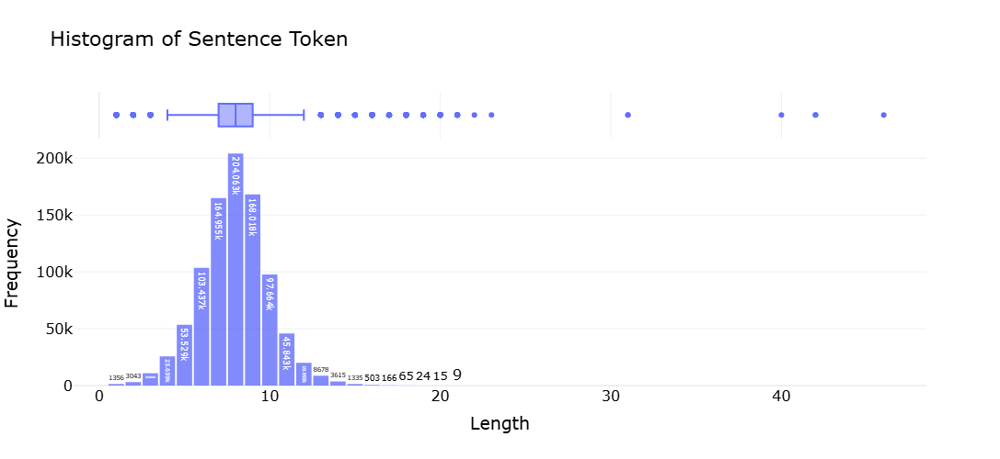

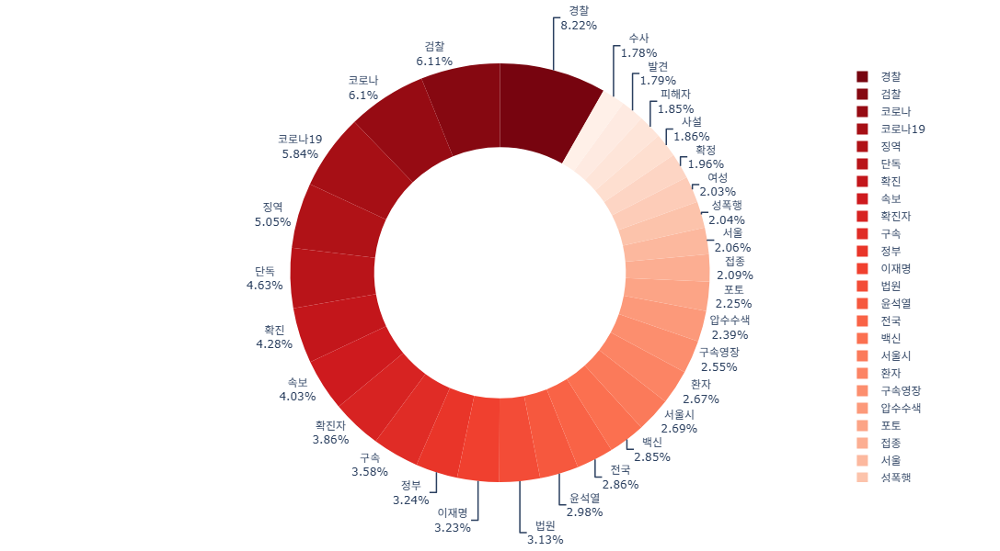

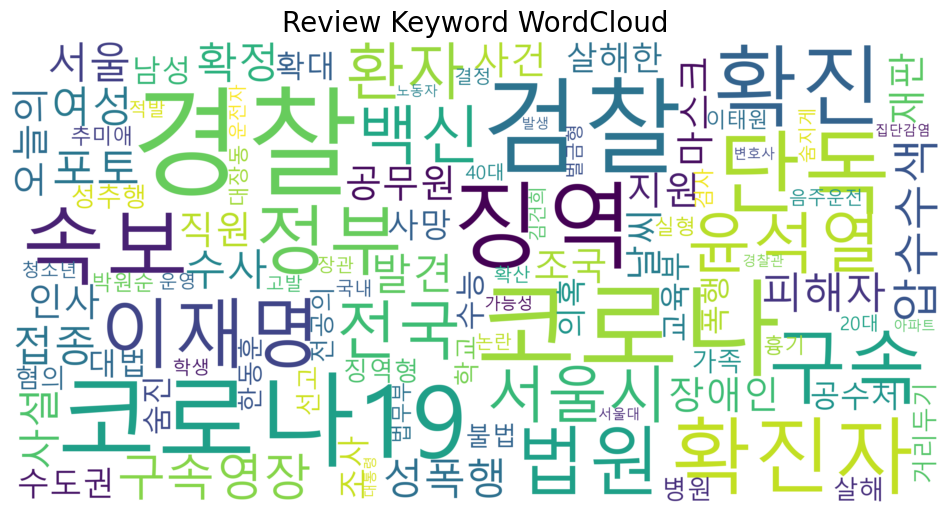

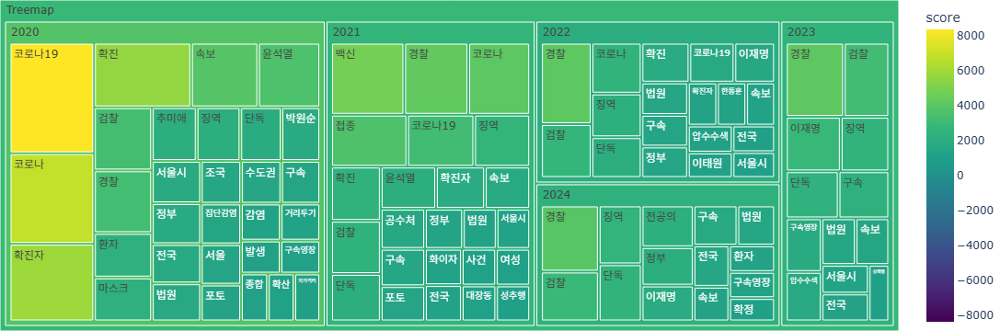

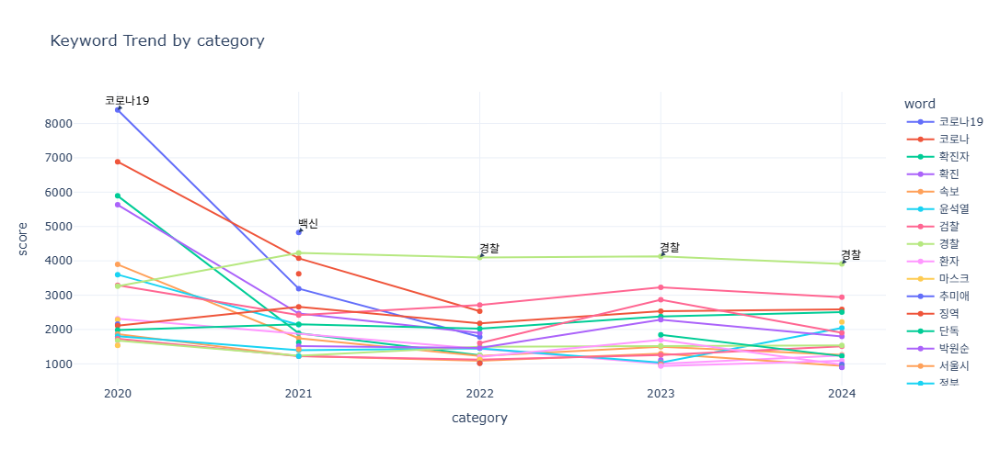

In [29]:
# 제목 토큰 길이 분포
plot_histogram_senttoken(df_freq['Token_'+TOKENIZER]) 

# 전체기간 주요키워드 분포
plot_donut_wordfreq(word_freq)
plot_wordcloud(word_freq, title='Review Keyword WordCloud', max_font_size=50, save_local=False)

# 연도별(리뷰) 주요키워드 분포
plot_treemap_wordfreq(word_freq_categ)

# 연도별 주요키워드 트랜드
## 연도별 주요키워드 상위10개 추출
df_plot = pd.DataFrame()
for year in word_freq_categ.category.unique():
    df_sub = word_freq_categ[word_freq_categ.category == year].iloc[:20,:]
    df_plot = pd.concat([df_plot, df_sub], axis=0)
## 트랜드 시각화
X = 'category'
Y = 'score'
COLOR = 'word'
fig = px.line(df_plot, x=X, y=Y, color=COLOR, markers=True,
              title="Keyword Trend by category")
## 각 고유 Viewing 값마다 weight가 가장 큰 데이터 포인트 추출
max_points = df_plot.loc[df_plot.groupby(X)[Y].idxmax()]
## 각 최대 weight 데이터 포인트 marker 근처에 source 이름을 annotation으로 추가
annotations = []
for idx, row in max_points.iterrows():
    annotations.append(dict(
        x=row[X],
        y=row[Y],
        xref="x",
        yref="y",
        text=row[COLOR],
        showarrow=True,
        arrowhead=2,
        ax=10,  # x 오프셋 (조정 가능)
        ay=-10, # y 오프셋 (조정 가능)
        font=dict(color="black", size=12)
    ))
fig.update_xaxes(tickmode='array', tickvals=df_plot[X].unique())
fig.update_layout(annotations=annotations, width=1000, height=500, showlegend=True)
fig.show()

In [ ]:
# 특정키워드의 연도별 인접어 트랜드
# for col in node_stat.columns[1:]:
#     ## 하위그룹
#     top_nodes = node_stat.sort_values(by=col, ascending=False).word[:2]
#     G_sub = G.subgraph(top_nodes)

#     ## 동시출현 시각화
#     net = Network(notebook=True)
#     net.from_nx(G_sub)
#     net.show_buttons(filter_=['physics'])
#     net.toggle_physics(False)
#     net.show('network_'+col+'.html')

#     ## 단어중요도 변화 시각화
#     df_plot = coword_directcateg[coword_directcateg.source.isin(top_nodes)].sort_values(by=['Year', 'weight'], ascending=[True, False])
#     fig = px.line(df_plot, x='Year', y='weight', color='target', markers=True,
#                   title="Year vs. Weight by Source")
#     # # 각 고유 Viewing 값마다 weight가 가장 큰 데이터 포인트 추출
#     # max_points = df_plot.loc[df_plot.groupby('Year')['weight'].idxmax()]
#     # # 각 최대 weight 데이터 포인트 marker 근처에 source 이름을 annotation으로 추가
#     # annotations = []
#     # for idx, row in max_points.iterrows():
#     #     annotations.append(dict(
#     #         x=row['Year'],
#     #         y=row['weight'],
#     #         xref="x",
#     #         yref="y",
#     #         text=row['source'],
#     #         showarrow=True,
#     #         arrowhead=2,
#     #         ax=10,  # x 오프셋 (조정 가능)
#     #         ay=-10, # y 오프셋 (조정 가능)
#     #         font=dict(color="black", size=12)
#     #     ))
#     # fig.update_layout(annotations=annotations, width=1000, height=500, showlegend=False)
#     fig.show()

# Topic Modeling

2025-05-09 19:07:47,536	INFO worker.py:1619 -- Calling ray.init() again after it has already been called.


Optimal Topic Number:  29


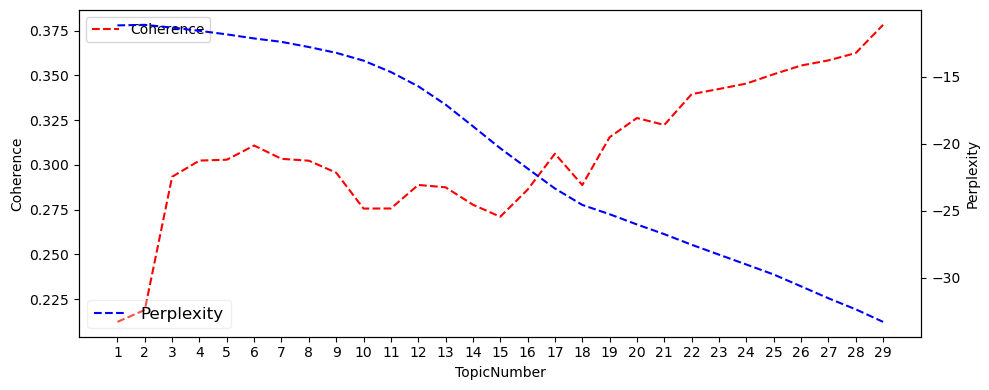

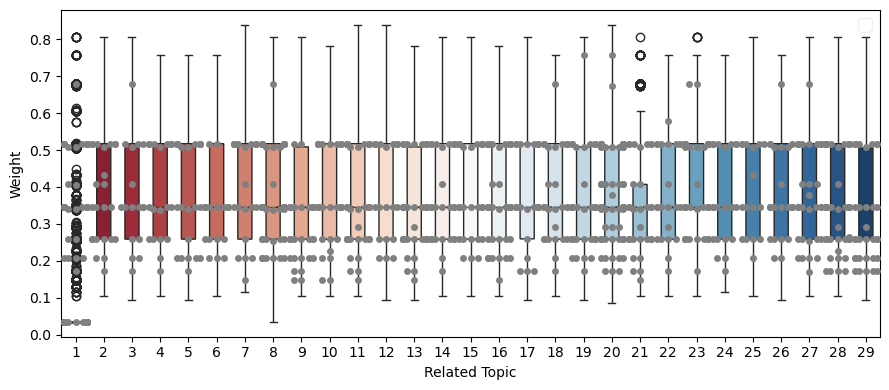

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'지하철(17.1%)', '개선(16.3%)', '관리(15.5%)', '필요(12.2%)', '인권위(7.6%)', '안전(7.0%)', '도심(6.6%)', '노인(6....",130604,0.1431,0.1083
Topic 2,"'수술(22.7%)', '중단(12.5%)', '연휴(11.7%)', '통제(9.0%)', '방역(8.8%)', '제주(8.8%)', '직접(7.0%)', '이어(6.8%)...",21876,0.0240,0.3492
Topic 3,"'시작(23.2%)', '가능(22.7%)', '생활(8.8%)', '등급(8.0%)', '줄어(7.2%)', '우수(6.9%)', '미국(6.1%)', '많아(6.1%)'...",13635,0.0149,0.3643
Topic 4,"'세계(19.0%)', '장관(18.6%)', '실시(17.7%)', '예산(10.0%)', '설치(9.5%)', '부담(6.4%)', '참석(4.9%)', '여름(4.6%...",16013,0.0175,0.3571
Topic 5,"'효과(20.5%)', '인사(17.2%)', '정책(15.9%)', '경기(12.8%)', '전면(6.9%)', '회장(6.5%)', '요구(5.9%)', '기후위기(5....",18665,0.0204,0.4018
Topic 6,"'신규(18.6%)', '다시(14.0%)', '무료(11.8%)', '모집(10.5%)', '기준(10.0%)', '개방(8.3%)', '사망자(7.9%)', '2배(6....",18545,0.0203,0.3739
Topic 7,"'가족(21.7%)', '확산(13.4%)', '늘어(11.6%)', '사용(10.5%)', '비상(10.1%)', '절반(8.5%)', '5년(7.8%)', '동참(7.4...",16250,0.0178,0.3551
Topic 8,"'코로나(46.4%)', '인천(15.5%)', '급증(7.4%)', '10명(6.0%)', '2명(5.2%)', '시대(4.3%)', '호소(4.1%)', '4명(3.9%...",45612,0.0500,0.3646
Topic 9,"'전국(24.9%)', '사설(19.2%)', '캠페인(12.0%)', '검토(10.3%)', '발표(8.5%)', '가능성(7.4%)', '의대(5.8%)', '찾아가는(...",32438,0.0355,0.3643
Topic 10,"'개최(25.9%)', '대응(17.9%)', '예방(10.3%)', '사고(7.8%)', '사회적(7.1%)', '지자체(6.7%)', '처리(6.4%)', '전문가(6....",19208,0.0210,0.3688


In [65]:
# 주요토픽 트랜드
## LDA 자동
save_name = SAVE_NAME_LDA.split('.')[0]+'_NR'+str(NGRAM_RANGE[1])+'Topic{}.xlsx'.format(NUM_TOPICS)

topic_kw_LDA, topic_doc_LDA, \
doc_topic_LDA, model_LDA = modeling_LDA(df_freq['Token_'+TOKENIZER], df_freq['TitlePrep'],
                                        num_topics=NUM_TOPICS, max_topics=MAX_TOPICS,
                                        num_topicwords=NUM_TOPICWORDS, num_topicsamples=NUM_TOPICSAMPLES,
                                        save_local=SAVE_LOCAL, save_name=save_name)
display(topic_kw_LDA)

[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy


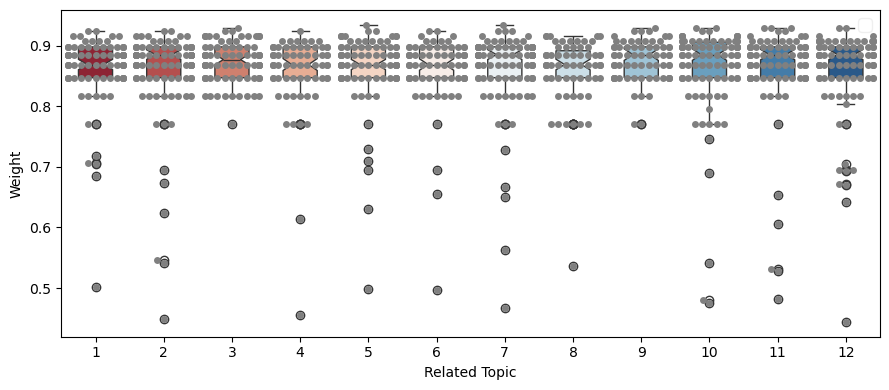

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'금지(14.8%)', '대학(13.0%)', '신입생(13.0%)', '모집(11.1%)', '정시(9.3%)', '아들(9.3%)', '학부모(9.3%)', '학교(9....",87,0.0870,0.8603
Topic 2,"'조국(23.7%)', '아들(13.6%)', '개최(11.9%)', '논란(8.5%)', '교육(8.5%)', '폐지(6.8%)', '유치원(6.8%)', '2020(6....",102,0.1020,0.8613
Topic 3,"'교육(11.9%)', '운영(11.9%)', '유은혜(11.9%)', '올해(11.9%)', '교사(11.9%)', '교육부(11.9%)', '선거교육(7.1%)', '법...",86,0.0860,0.8616
Topic 4,"'학교(17.5%)', '겨울방학(12.5%)', '정시(10.0%)', '대치동(10.0%)', '수능(10.0%)', '수학(10.0%)', '학생(7.5%)', '문제...",66,0.0660,0.8587
Topic 5,"'모집(16.7%)', '하향(13.0%)', '학교(13.0%)', '촉법소년(9.3%)', '교육부(9.3%)', '변호사(9.3%)', '대상(7.4%)', '편입생(...",89,0.0890,0.8641
Topic 6,"'조국(13.3%)', '선정(11.1%)', '아들(11.1%)', '확대(11.1%)', '대리시험(11.1%)', '교수(8.9%)', '대입(8.9%)', '학교폭력...",72,0.0720,0.8754
Topic 7,"'학생(18.6%)', '겨울방학(11.6%)', '교사(11.6%)', '교육(9.3%)', '실시(9.3%)', '개강(9.3%)', '조원태(9.3%)', '서울시교육...",97,0.0970,0.8562
Topic 8,"'유은혜(16.3%)', '대학(12.2%)', '부총리(12.2%)', '학교(12.2%)', '정시모집(8.2%)', '2020학년도(8.2%)', '등록금(8.2%)'...",63,0.0630,0.8563
Topic 9,"'징계(15.9%)', '교육(13.6%)', '교사(13.6%)', '서울(9.1%)', '자녀(9.1%)', '유권자(9.1%)', '올해(9.1%)', '고교(6.8%...",69,0.0690,0.8609
Topic 10,"'학생(13.6%)', '논란(11.4%)', '개최(11.4%)', '인권위(9.1%)', '접수(9.1%)', '서울대(9.1%)', '2020(9.1%)', '원장(9...",94,0.0940,0.8744


,Topic Number,Weight,TitlePrep
204,Topic 1,0.9236,드라마 블랙독과 현실의 학교 현실대로라면 고하늘 선생님은 정규 교사 되기 어려울 것
618,Topic 1,0.9236,애들 원비로 명품백 유치원장 앞으로 형사처벌 받는다 유치원 3법 국회 통과
375,Topic 1,0.9167,열려라 공부 미래 교육 목표는 행복한 삶 창의성 키우는 교육문화 조성
124,Topic 1,0.9167,단독 생각하십니까 ai 대학원 입학원서 낸 서울대 교수 서류 탈락한 사연
576,Topic 1,0.9167,정유라 체육특기생이라도 결석 눈감아 준 것은 잘못 法 고교 담임교사 해임 정당
283,Topic 2,0.9236,역경의 열매 김인숙 11 스스로 삶에 목소리 내도록 아동 힘 키우기 돌입
594,Topic 2,0.9236,조국 기소 통보 받은 서울대 직위해제 결정 못 해 내용 부족해 추가 요청
500,Topic 2,0.9167,조국 아들 출결 조사한 서울시교육청교사 말만 듣고 단순 실수 결론
534,Topic 2,0.9167,서울교육청 조국 아들 출석 특혜 없었다 허위 인턴증명서는 확인 불가
798,Topic 2,0.9167,정년퇴직 코 앞인데 파면하라 위안부 망언 류석춘 수업 개설에 거센 반발


,TitlePrep,Related Topic,Weight,Each Topic Weights
0,2020 신년사 도성훈 인천교육감 민주시민 참여 교육공동체 만드는데 중점,9,0.9083,"[(8, 0.90832007)]"
1,단독 민주당 사법농단 이탄희 영입 불발 이수정은 고민 중,7,0.8981,"[(6, 0.89813286)]"
2,충남도교육청 학부모 교육참여 우수사례 공모전 수상 쾌거,4,0.8854,"[(0, 0.010418237), (1, 0.01041815), (2, 0.0104181245), (3, 0.8854006), (4, 0.010418153), (5, 0.0..."
3,칠곡군 향토생활관 입사생 108명 모집,1,0.8472,"[(0, 0.8472005), (1, 0.01389078), (2, 0.013890918), (3, 0.013890803), (4, 0.013891004), (5, 0.01..."
4,2020 주요 대학 정시경쟁률 학령인구 감소 까다로운 수능 영향 하락,8,0.9167,"[(7, 0.9166546)]"
...,...,...,...,...
995,학교폭력 예방 학생들이 먼저 나서야죠,1,0.8472,"[(0, 0.8471983), (1, 0.013890897), (2, 0.013891037), (3, 0.013891064), (4, 0.013891033), (5, 0.0..."
996,투표권 비율 갈등 안풀려 파행 치닫는 부산대 총장 선거,10,0.9083,"[(9, 0.9083184)]"
997,제1회 홍남순 변호사 인권상에 경기중앙변호사회 최정규씨,11,0.8472,"[(0, 0.013891279), (1, 0.013891279), (2, 0.013891644), (3, 0.013891359), (4, 0.013892668), (5, 0..."
998,외부 법률전문가 영입 늘려 검사 직무 대신해야,1,0.8690,"[(0, 0.8690252), (1, 0.011906716), (2, 0.011906962), (3, 0.011906716), (4, 0.011906716), (5, 0.0..."


In [64]:
# # 주요토픽 트랜드
# ## LDA 수동
# NUM_TOPICS_EX = 12
# save_name = SAVE_NAME_LDA.split('.')[0]+'_NR'+str(NGRAM_RANGE[1])+'Topic{}.xlsx'.format(NUM_TOPICS_EX)

# topic_kw_LDA, topic_doc_LDA, \
# doc_topic_LDA, model_LDA = modeling_LDA(df_freq['Token_'+TOKENIZER], df_freq['TitlePrep'],
#                                         num_topics=NUM_TOPICS_EX, num_topicwords=NUM_TOPICWORDS, num_topicsamples=NUM_TOPICSAMPLES,
#                                         save_local=SAVE_LOCAL, save_name=save_name)
# display(topic_kw_LDA, topic_doc_LDA, doc_topic_LDA)

2020.0


2025-05-09 20:54:38,583	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 


Optimal Topic Number:  29


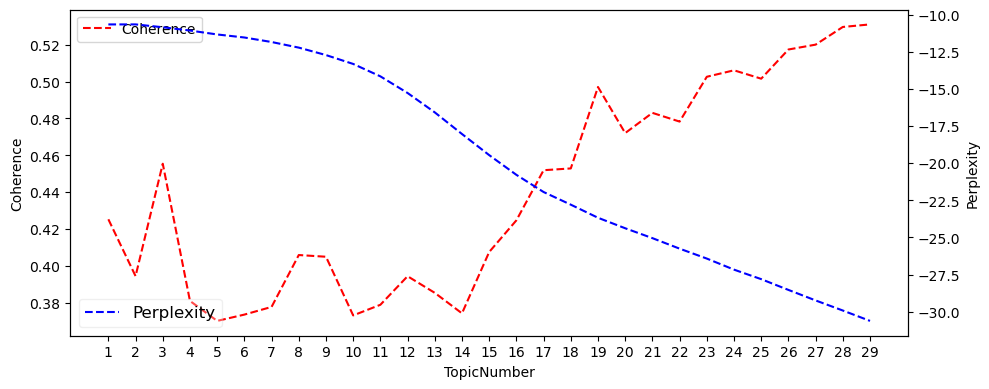

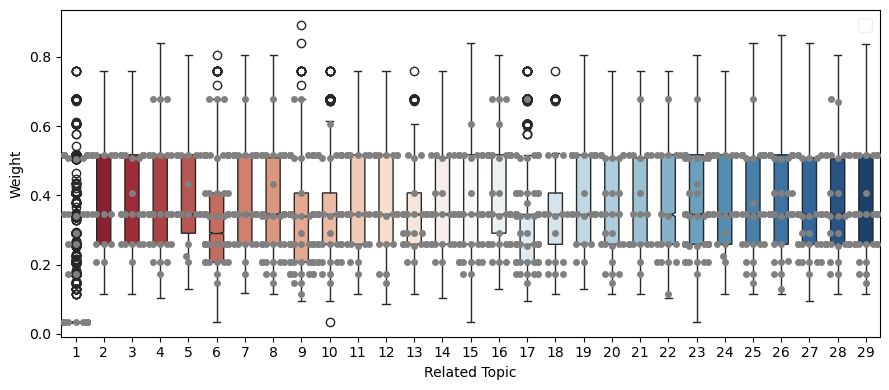

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'5명(18.8%)', '기부(16.4%)', '인권위(11.6%)', '아냐(9.8%)', '전북(8.9%)', '점검(7.7%)', '법원(7.1%)', '먼저(6.8%...",24391,0.1177,0.1085
Topic 2,"'신규(32.8%)', '대구(15.8%)', '4명(13.3%)', '최초(8.5%)', '50대(6.9%)', '모든(5.6%)', '양성(5.2%)', '설치(4.6%...",3930,0.0190,0.3641
Topic 3,"'사망(46.1%)', '올해(10.6%)', '통제(9.7%)', '적용(6.9%)', '14명(5.4%)', '호소(5.0%)', '협약(5.0%)', '이하(4.0%)...",5290,0.0255,0.3495
Topic 4,"'사설(26.4%)', '대상(15.3%)', '2차(13.0%)', '국민(11.1%)', '모집(8.0%)', '안전(6.5%)', '전문가(6.5%)', '엄마(4.7...",5969,0.0288,0.3602
Topic 5,"'급증(22.8%)', '서울포토(14.4%)', '13명(11.2%)', '20(9.2%)', '추미애(8.0%)', '복귀(7.2%)', '나선(7.2%)', '허가(7...",4807,0.0232,0.3643
Topic 6,"'확진(42.1%)', '서울(25.3%)', '국내(11.7%)', '3명(4.9%)', '수술(4.2%)', '이어(2.9%)', '접촉(2.7%)', '세계(2.4%)...",11621,0.0561,0.3598
Topic 7,"'포토(27.7%)', '2020(11.9%)', '사회적(11.9%)', '지정(11.7%)', '미국(8.0%)', 'ai(7.0%)', '지속(6.8%)', '불법(6...",5707,0.0275,0.3389
Topic 8,"'개발(21.5%)', '관리(16.7%)', '공개(12.4%)', '의혹(10.9%)', '부천(9.7%)', '비하(6.1%)', '청소년(6.1%)', '16명(5....",6442,0.0311,0.3449
Topic 9,"'코로나(64.7%)', '단독(8.3%)', '확인(5.5%)', '인천시(4.9%)', '시작(3.7%)', '캠페인(3.2%)', '상황(3.1%)', '시대(2.4%...",13665,0.0659,0.3699
Topic 10,"'검사(27.4%)', '증가(13.7%)', '경기(13.2%)', '가장(10.3%)', '발표(7.3%)', '2020년(7.1%)', '음주운전(6.4%)', '징역...",8848,0.0427,0.3235


2021.0


2025-05-09 21:15:30,859	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 


Optimal Topic Number:  28


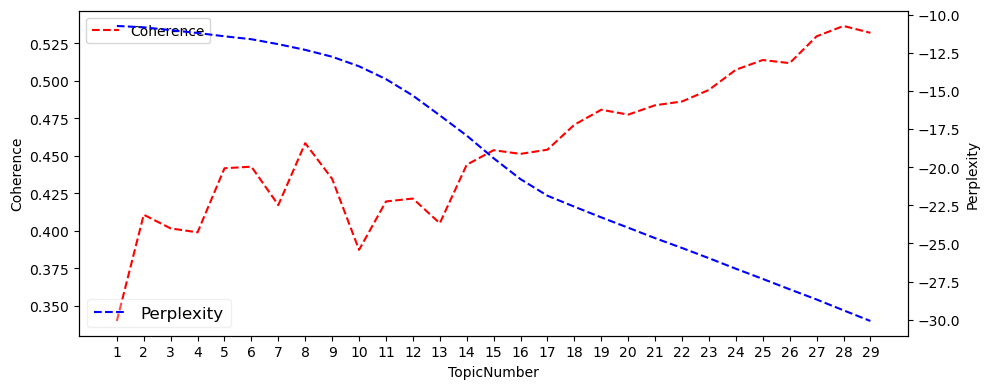

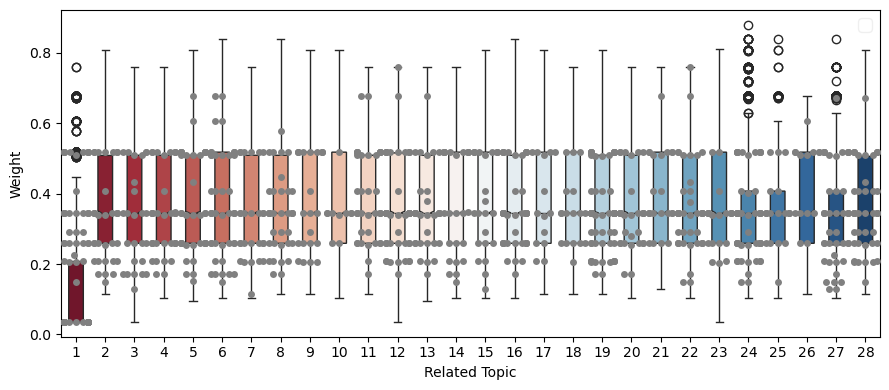

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'서울시(27.7%)', '환자(27.7%)', '전국(12.1%)', '변이(7.4%)', '발견(6.2%)', '인정(4.1%)', '음주운전(3.9%)', '사례(3....",22173,0.1177,0.1304
Topic 2,"'단독(30.4%)', '2차(22.1%)', '이어(8.6%)', '서울시의원(7.2%)', '집단(5.8%)', '사회적(5.8%)', '6명(5.5%)', '성폭력(5...",5596,0.0297,0.3686
Topic 3,"'거리두기(16.8%)', '개선(14.3%)', '추진(13.8%)', '경기도(9.8%)', '숨져(9.0%)', '10명(8.8%)', '기준(8.5%)', '조사(7...",4371,0.0232,0.3644
Topic 4,"'사망(26.5%)', '지원(24.5%)', '수상(9.5%)', '감소(9.1%)', '남성(7.0%)', '이후(7.0%)', '미국(6.2%)', '경향포토(3.5%...",6966,0.0370,0.3828
Topic 5,"'수도권(37.9%)', '경찰(11.8%)', '지자체(9.6%)', '성인(7.4%)', '2주(6.6%)', 'qa(6.3%)', '의무화(6.0%)', '모집(5.2...",9348,0.0496,0.3462
Topic 6,"'국내(23.5%)', '다시(14.4%)', '논란(13.8%)', '기고(11.7%)', '평가(8.4%)', '인증(7.6%)', '지역(5.5%)', '위반(5.5%...",6708,0.0356,0.3609
Topic 7,"'정부(35.7%)', '선정(12.5%)', '가족(12.1%)', '개최(10.0%)', '관리(7.2%)', '아들(5.7%)', '모든(5.5%)', '의료진(5.3...",5414,0.0287,0.3558
Topic 8,"'검사(21.1%)', '30대(16.6%)', '2021(14.2%)', '결과(12.8%)', '아냐(8.6%)', '본격(6.2%)', '지급(5.9%)', '돌입(5...",6435,0.0342,0.3569
Topic 9,"'운영(22.2%)', '국민(17.6%)', '건강(13.8%)', '친환경(11.4%)', '비상(8.9%)', '달성(7.6%)', '사실상(4.9%)', '돌봄(4....",3815,0.0203,0.3394
Topic 10,"'역대(19.0%)', '시작(17.9%)', '증가(12.8%)', '예방(9.0%)', '감축(8.1%)', '의사(8.1%)', '진행(7.7%)', '내일(6.5%)...",4021,0.0213,0.3750


2022.0


2025-05-09 21:34:43,438	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 


Optimal Topic Number:  28


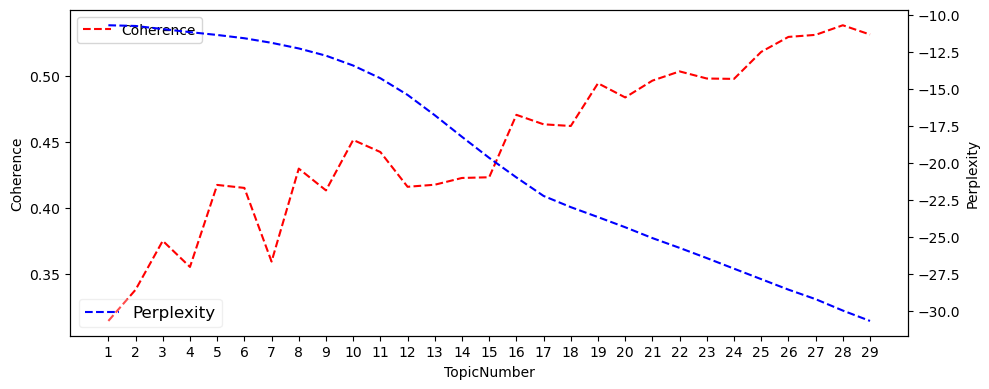

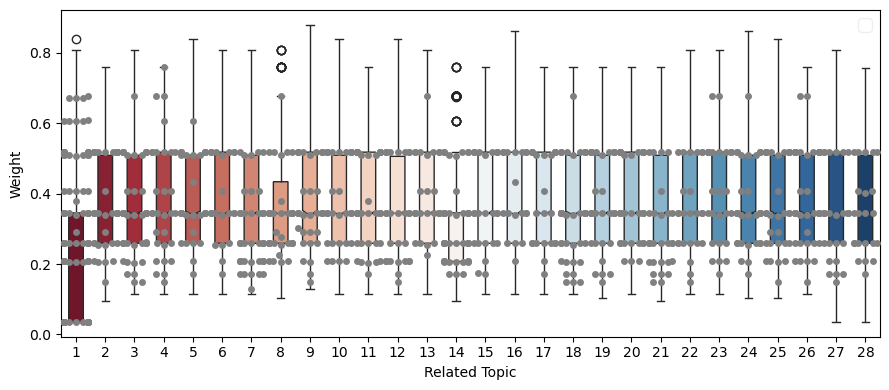

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'장애인(54.5%)', '경찰(7.9%)', '미세먼지(7.1%)', '진료(6.5%)', '개발(5.4%)', '국민(5.4%)', '조사(3.6%)', '불법(3.5%...",26152,0.1578,0.1850
Topic 2,"'환자(37.8%)', '시위(22.7%)', '늘어(6.5%)', '가능성(5.5%)', '적발(5.0%)', '한국(5.0%)', '교수(4.6%)', '2명(4.6%)...",7129,0.0430,0.3612
Topic 3,"'증가(16.0%)', '속보(15.6%)', '유행(12.2%)', '추진(11.5%)', '추가(9.7%)', '감소(8.8%)', '실시(8.6%)', '당국(7.2%...",6241,0.0377,0.3471
Topic 4,"'위험(30.0%)', '연속(12.4%)', '청소년(8.9%)', '인정(7.8%)', '2년(7.5%)', '방역패스(7.5%)', '사고(7.2%)', '시민(6.6...",4419,0.0267,0.3654
Topic 5,"'백신(31.4%)', '접종(25.1%)', '오미크론(15.7%)', '비상(4.3%)', '권고(4.3%)', 'pcr(4.3%)', '대책(3.9%)', '선택(3....",6503,0.0392,0.3571
Topic 6,"'가족(21.8%)', '효과(12.6%)', '세계(11.7%)', '대비(11.2%)', '3년(9.1%)', '격리(8.4%)', '있는(8.0%)', '의무(7.5%...",3720,0.0224,0.3610
Topic 7,"'정부(33.6%)', '인사(11.9%)', '검토(11.1%)', '기부(10.7%)', '인증(7.3%)', '법원(6.7%)', '마련(5.5%)', '착용(4.9%...",6243,0.0377,0.3364
Topic 8,"'50대(13.9%)', '여가부(13.9%)', '폐지(13.2%)', '피해자(12.0%)', '전환(10.7%)', '전면(7.9%)', '의원(7.3%)', '김건희...",5330,0.0322,0.3532
Topic 9,"'의사(20.2%)', '1위(10.9%)', '배출(10.5%)', '시대(9.4%)', '결정(9.4%)', '2차(8.2%)', '같은(8.2%)', '일자리(8.2%...",3603,0.0217,0.3501
Topic 10,"'지원(33.5%)', '수술(13.6%)', '하루(13.3%)', '인천(10.6%)', '2022년(5.7%)', '중증(5.5%)', '구축(5.1%)', '대법(4...",5460,0.0329,0.3427


2023.0


2025-05-09 21:51:25,625	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 


Optimal Topic Number:  28


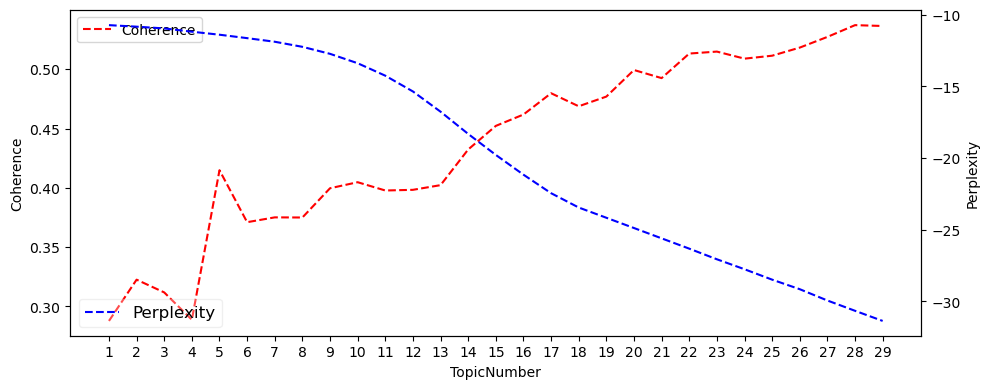

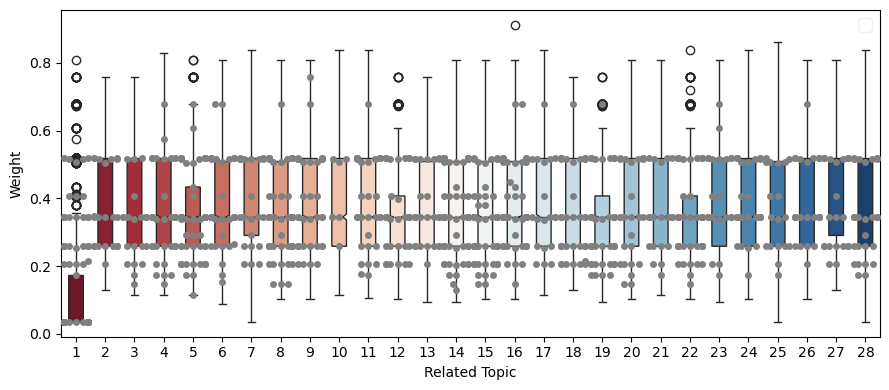

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'치료(24.2%)', '사설(17.4%)', '강화(15.5%)', '대책(8.2%)', '서비스(8.2%)', '활동(7.5%)', '공개(5.6%)', '대구(4.8%...",22759,0.1244,0.1193
Topic 2,"'선정(18.0%)', '규제(11.7%)', '연속(11.7%)', '시민(11.4%)', '2023년(10.8%)', '5년(9.9%)', '4명(7.2%)', '계속(...",4096,0.0224,0.3697
Topic 3,"'경기도(16.3%)', '개발(14.6%)', '다시(13.9%)', '전달(13.1%)', '3년(11.1%)', '문제(7.4%)', '서울25(7.2%)', '평균(...",3275,0.0179,0.3640
Topic 4,"'피해(15.4%)', '무료(14.8%)', '3명(11.6%)', '60대(11.0%)', '검토(10.4%)', '기준(9.2%)', '표창(7.7%)', '단속(7....",4981,0.0272,0.3556
Topic 5,"'확대(30.7%)', '징역(12.1%)', '1년(8.4%)', '사고(8.1%)', '음주운전(7.9%)', '신규(7.1%)', '혐의(7.1%)', '체포(6.6%...",10107,0.0552,0.3572
Topic 6,"'위험(28.4%)', '코로나19(16.2%)', '20대(14.9%)', '높아(7.6%)', '확진(7.1%)', '소송(6.3%)', '아냐(6.1%)', '수준(5...",6502,0.0355,0.3840
Topic 7,"'실시(24.8%)', '최고(10.7%)', '돌봄(10.3%)', '차별(9.3%)', '직접(8.3%)', '신고(7.9%)', '역대(7.6%)', '받아(7.2%)...",4589,0.0251,0.3620
Topic 8,"'단독(40.1%)', '발견(14.3%)', '오늘의(9.2%)', '숨진(7.4%)', '확산(5.7%)', 'cctv(5.2%)', '정보(4.9%)', '겨울(4.6...",7920,0.0433,0.3920
Topic 9,"'지원(31.0%)', '운영(13.9%)', '건강한(11.9%)', '기부(7.6%)', '남성(7.6%)', '도입(6.7%)', '세계(6.5%)', '아동(5.4%...",7956,0.0435,0.3546
Topic 10,"'2023(38.0%)', '제로(11.7%)', '부산(9.9%)', '전문가(7.7%)', '일상(7.1%)', '새로운(5.9%)', '성희롱(5.9%)', '80(4...",2134,0.0117,0.3627


2024.0


2025-05-09 22:10:08,743	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 


Optimal Topic Number:  28


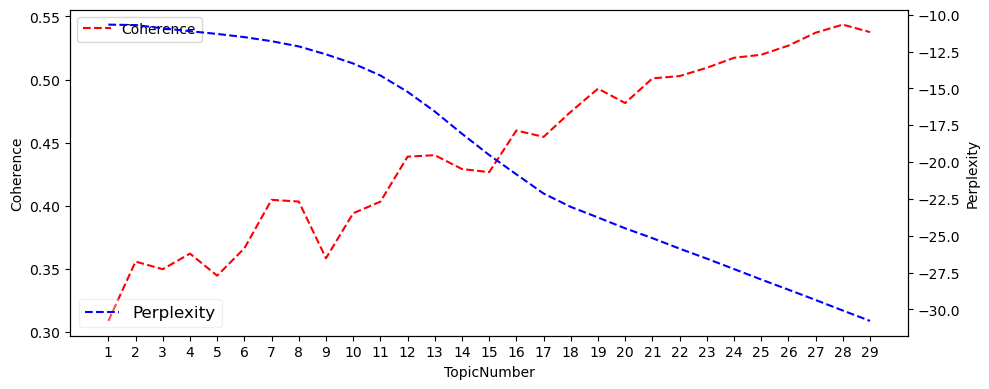

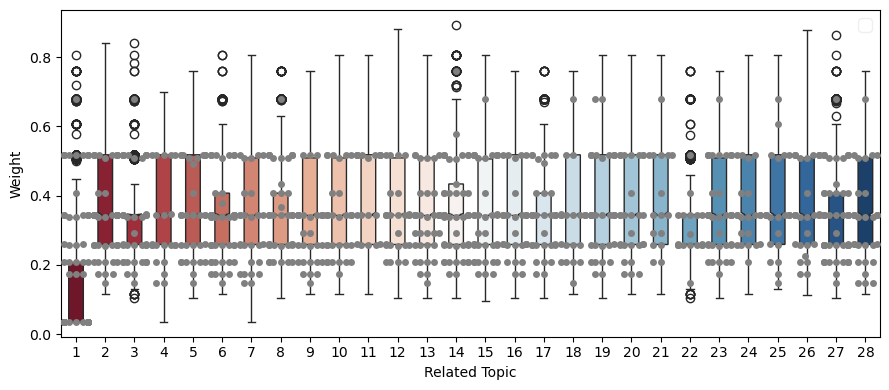

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'서울(40.3%)', '속보(13.6%)', '서울시의원(11.8%)', '감축(7.1%)', '겨울(5.5%)', '촉구(5.3%)', '가능성(4.6%)', '가동(4...",19991,0.1187,0.1275
Topic 2,"'포토(37.1%)', '복귀(10.1%)', '지정(10.1%)', '추가(9.6%)', '결혼(7.1%)', '발표(6.1%)', '없어(5.8%)', '3명(5.1%)...",4897,0.0291,0.3382
Topic 3,"'여성(38.2%)', '올해(12.6%)', '경기도(9.3%)', '다시(6.6%)', '공무원(6.6%)', '모든(6.2%)', '신규(5.7%)', '역대(5.3%...",6769,0.0402,0.3446
Topic 4,"'코로나(21.2%)', '최고(14.2%)', '시작(12.6%)', '빅5(11.3%)', '1명(8.9%)', '4명(7.5%)', '영향(7.3%)', '나선(5.9...",3641,0.0216,0.3343
Topic 5,"'치료(24.7%)', '개선(14.2%)', '발견(10.3%)', '사고(9.2%)', '중단(9.2%)', '거부(8.1%)', '영상(6.9%)', '예산(6.9%)...",5068,0.0301,0.3469
Topic 6,"'사망(23.8%)', '위험(19.4%)', '사설(18.2%)', '대책(7.6%)', '대비(6.9%)', '비상(6.1%)', '작년(5.4%)', '오늘부터(4.7...",7090,0.0421,0.3621
Topic 7,"'인천(16.6%)', '피해(16.6%)', '투입(14.8%)', '피해자(9.3%)', '국가(7.8%)', '사람(7.5%)', '결과(7.5%)', '충격(6.9%...",4807,0.0285,0.3631
Topic 8,"'교수(21.2%)', '교수들(11.6%)', '30대(11.3%)', '1년(9.0%)', '발령(9.0%)', '직접(8.1%)', '혐의(8.1%)', '세상(7.5...",7103,0.0422,0.3409
Topic 9,"'논란(16.1%)', '기부(14.6%)', '도입(12.3%)', '위기(11.1%)', '개발(10.8%)', 'ai(8.5%)', '없다(7.6%)', '시대(6.6...",5911,0.0351,0.3550
Topic 10,"'예방(14.4%)', '수사(12.8%)', '40대(11.6%)', '기업(11.3%)', '절반(11.0%)', '규제(8.6%)', '수도권(8.6%)', '24시간...",6451,0.0383,0.3512


In [66]:
# 연도별 주요토픽 트랜드
for year in df_freq.Year.unique():
    print(year)
    ## 데이터 분리
    save_name = SAVE_NAME_LDA.split('.')[0]+'_NR'+str(NGRAM_RANGE[1])+'Topic{}_{}.xlsx'.format(NUM_TOPICS, str(year)[:4])
    df_sub = df_freq[df_freq.Year == year].reset_index().iloc[:,1:]

    ## LDA 자동
    topic_kw_LDA, topic_doc_LDA, \
    doc_topic_LDA, model_LDA = modeling_LDA(df_sub['Token_'+TOKENIZER], df_sub['TitlePrep'],
                                            num_topics=NUM_TOPICS, max_topics=MAX_TOPICS,
                                            num_topicwords=NUM_TOPICWORDS, num_topicsamples=NUM_TOPICSAMPLES,
                                            save_local=SAVE_LOCAL, save_name=save_name)
    display(topic_kw_LDA)

# Sentiment Analysis